## Image Registration


In [37]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow
import imutils

In [25]:
image_1_color = cv2.imread('book_sample.jpeg')
image_2_color = cv2.imread('book_reference.jpeg')
print('image_1 resolution = %d x %d'%(image_1_color.shape[0], image_1_color.shape[1]))
print('image_1 resolution = %d x %d'%(image_2_color.shape[0], image_2_color.shape[1]))


image_1 resolution = 3072 x 4096
image_1 resolution = 3072 x 4096


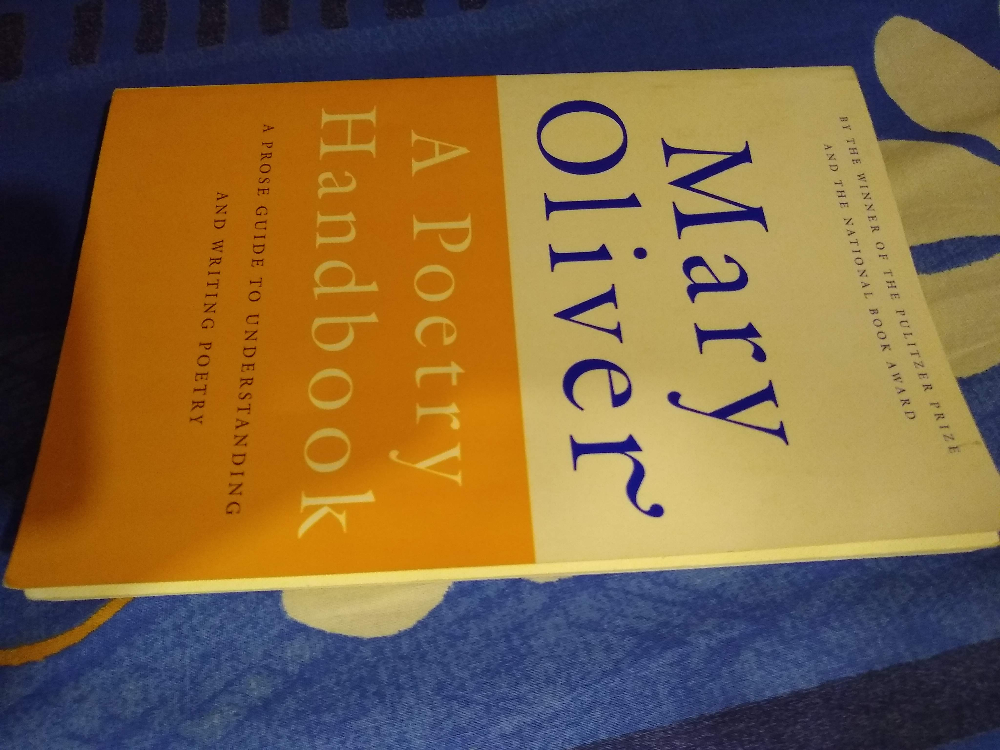

In [26]:
cv2_imshow(image_1_color)

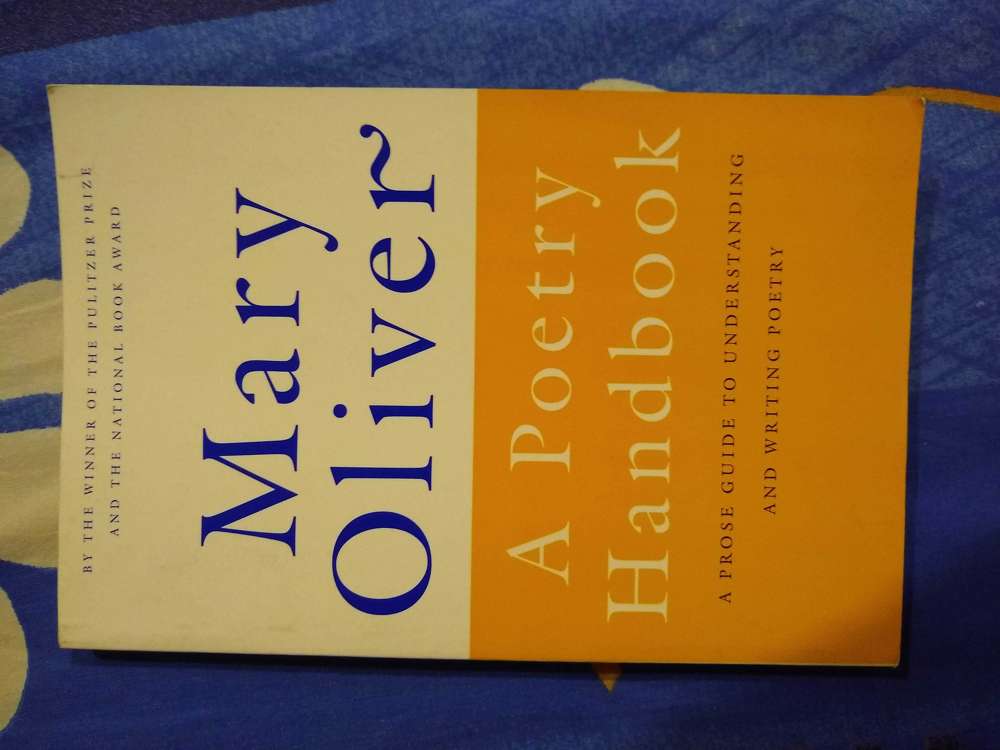

In [27]:
cv2_imshow(image_2_color)

In [28]:
# Converting the image to grayscale
input_img = cv2.cvtColor(image_1_color, cv2.COLOR_BGR2GRAY)
height, width = input_img.shape
ref_img = cv2.cvtColor(image_2_color, cv2.COLOR_BGR2GRAY)

In [29]:
# Creating Orb detector
orb_detector = cv2.ORB_create(5000)
# Finding the tie points
tie_p1, d1 = orb_detector.detectAndCompute(input_img, None)
tie_p2, d2 = orb_detector.detectAndCompute(ref_img, None)

In [45]:
# Match features between the two images.
# We create a Brute Force matcher with
# Hamming distance as measurement mode.
matcher = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck = True)
# Match the two sets of descriptors.
matches = matcher.match(d1, d2, None)
# Sort matches on the basis of their Hamming distance.
matches = sorted(matches, key=lambda x: x.distance)
# Taking the top 90% matches
matches = matches[:int(len(matches)*0.9)]

### Homography Matrix to transform the color image with the reference image.

In [46]:
# Initializing the matrix
M1 = np.zeros((len(matches),2))
M2 = np.zeros((len(matches),2))
# Populating the matrix with matches and their correspoiding tie points
for i in range(len(matches)):
  M1[i:] = tie_p1[matches[i].queryIdx].pt
  M2[i:] = tie_p2[matches[i].trainIdx].pt

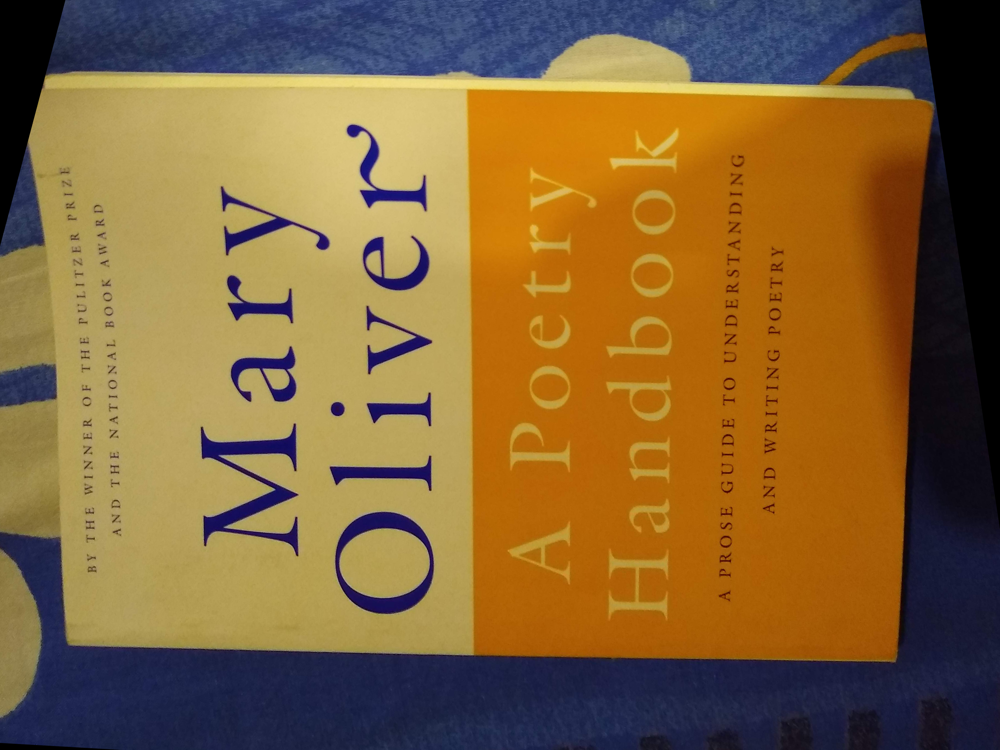

In [47]:
# Finding the homography matrix.
homography, mask = cv2.findHomography(M1, M2, cv2.RANSAC)

# Using the matrix to transform the color image
transform_img = cv2.warpPerspective(image_1_color, homography, (image_2_color.shape[1], image_2_color.shape[0]))
# Displaying the resultant image
cv2_imshow(transform_img)

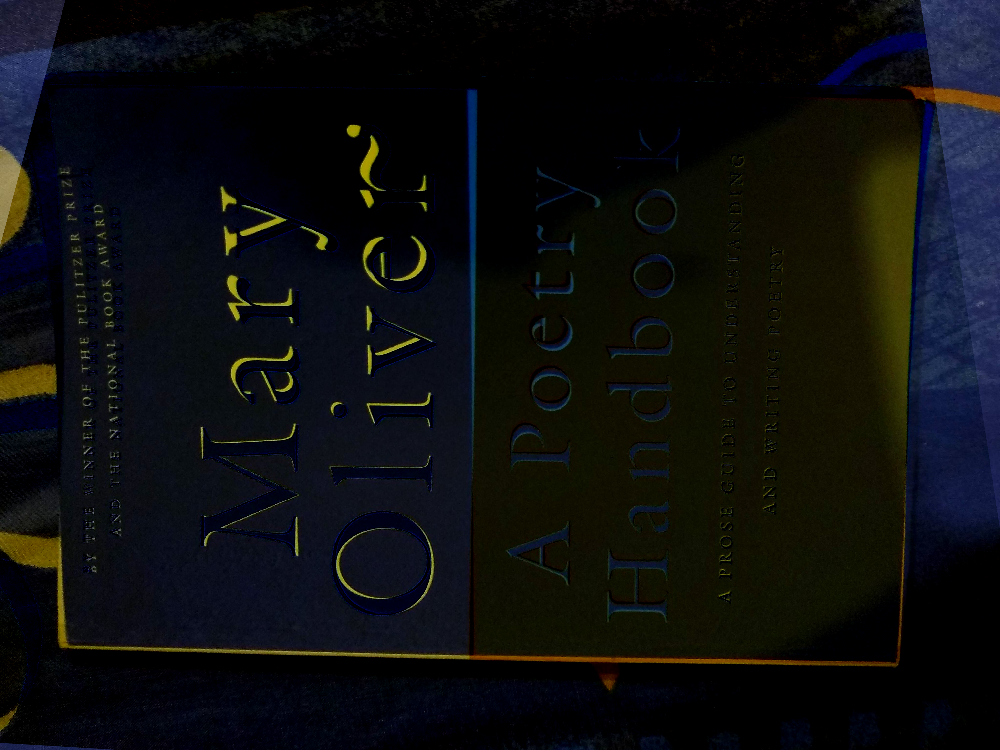

In [48]:
# Checking the difference between the transformed image and the reference image.
difference = cv2.subtract(image_2_color, transform_img)
cv2_imshow(difference)

### Visualizing feature matches

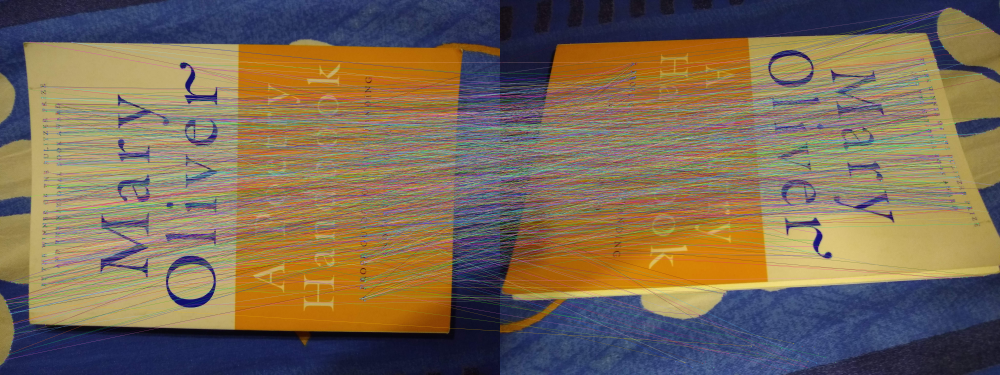

In [38]:
matches_visual = cv2.drawMatches(image_2_color, tie_p2, image_1_color, tie_p1, matches, None)
matches_visual = imutils.resize(matches_visual, width=1000)
cv2_imshow(matches_visual)